In [1]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix ,accuracy_score ,classification_report
import joblib

In [2]:
data = pd.read_csv('E:\programming\AI\Coding\diabetes detection\Data\diabetes.csv')

In [3]:
data

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,2,138,62,35,0,33.6,0.127,47,1
1,0,84,82,31,125,38.2,0.233,23,0
2,0,145,0,0,0,44.2,0.630,31,1
3,0,135,68,42,250,42.3,0.365,24,1
4,1,139,62,41,480,40.7,0.536,21,0
...,...,...,...,...,...,...,...,...,...
1995,2,75,64,24,55,29.7,0.370,33,0
1996,8,179,72,42,130,32.7,0.719,36,1
1997,6,85,78,0,0,31.2,0.382,42,0
1998,0,129,110,46,130,67.1,0.319,26,1


## Data Cleaning


In [4]:
data.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [5]:
data.tail().isnull()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
1995,False,False,False,False,False,False,False,False,False
1996,False,False,False,False,False,False,False,False,False
1997,False,False,False,False,False,False,False,False,False
1998,False,False,False,False,False,False,False,False,False
1999,False,False,False,False,False,False,False,False,False


In [6]:
data.isnull().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

## Data Visualization 

array([[<AxesSubplot:title={'center':'Pregnancies'}>,
        <AxesSubplot:title={'center':'Glucose'}>,
        <AxesSubplot:title={'center':'BloodPressure'}>],
       [<AxesSubplot:title={'center':'SkinThickness'}>,
        <AxesSubplot:title={'center':'Insulin'}>,
        <AxesSubplot:title={'center':'BMI'}>],
       [<AxesSubplot:title={'center':'DiabetesPedigreeFunction'}>,
        <AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Outcome'}>]], dtype=object)

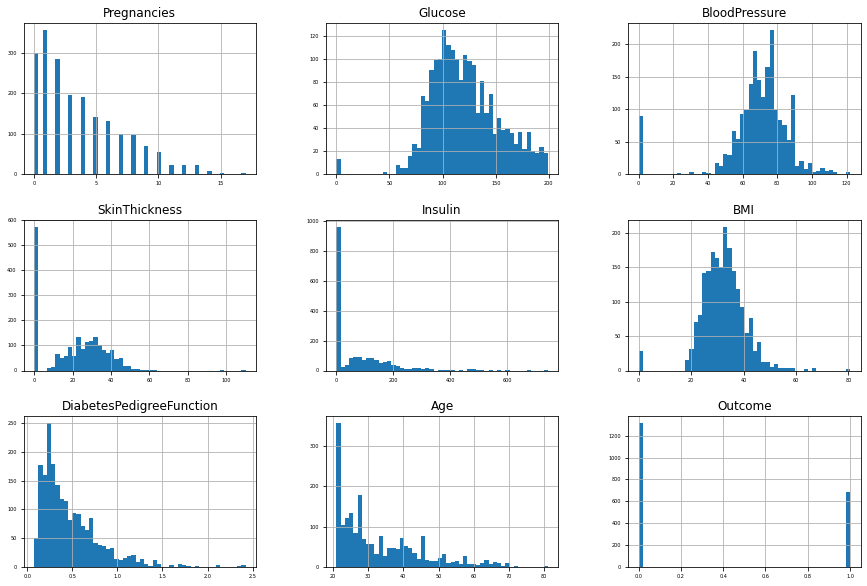

In [7]:
data.hist(figsize=(15, 10), bins=50, xlabelsize=5, ylabelsize=5)

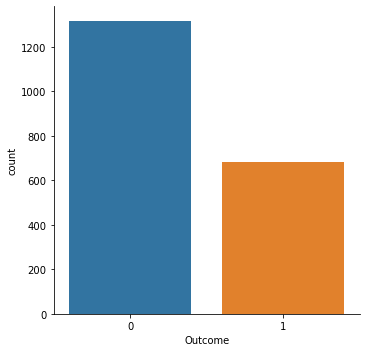

In [8]:
sns.catplot(x="Outcome",data=data, kind="count")

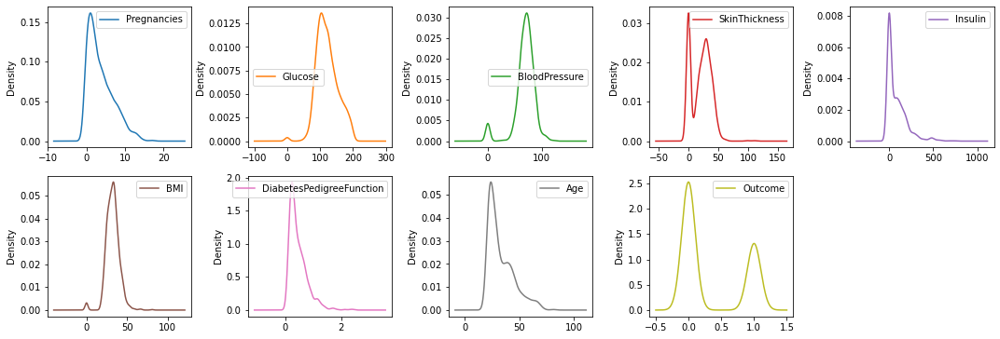

In [9]:
data.plot(kind="density", layout=(6,5),subplots=True,sharex=False, sharey=False, figsize=(15,15))
plt.tight_layout() 

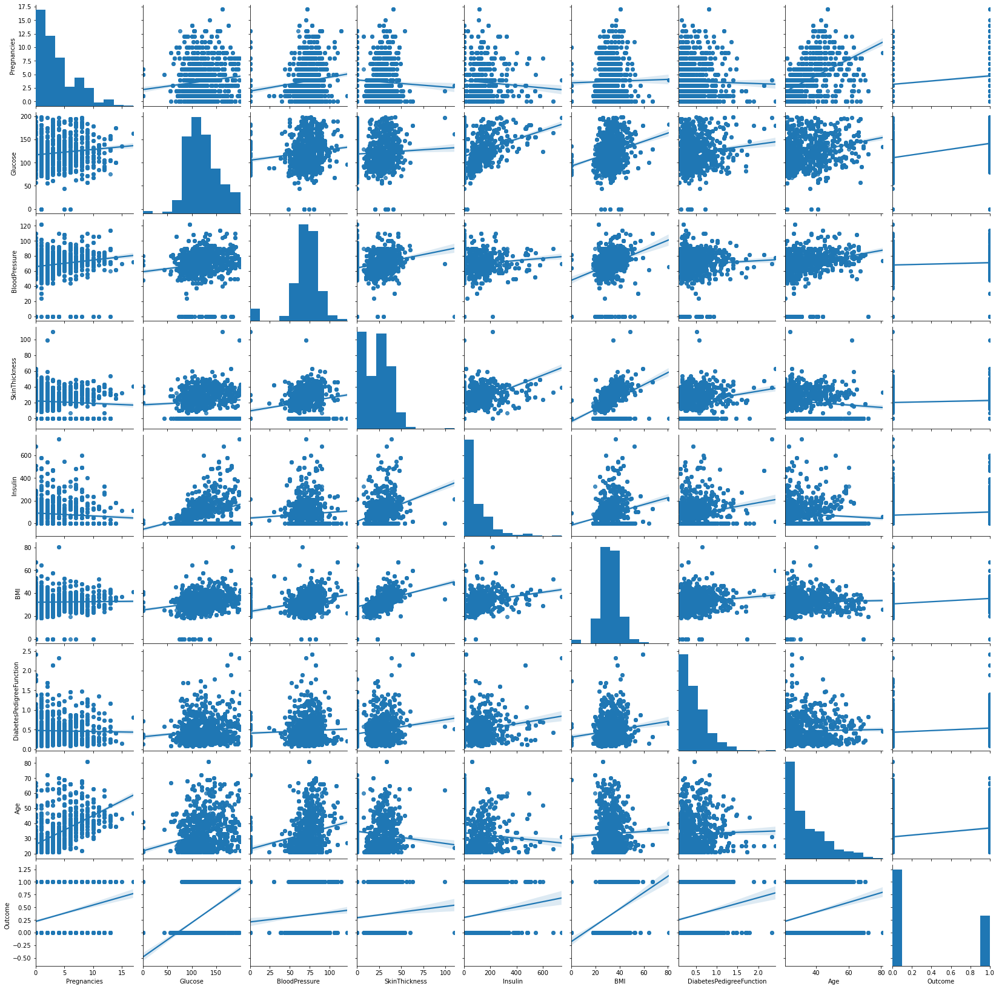

In [31]:
sns.pairplot(data, kind = "reg")

<AxesSubplot:title={'center':'Correlation Heatmap'}>

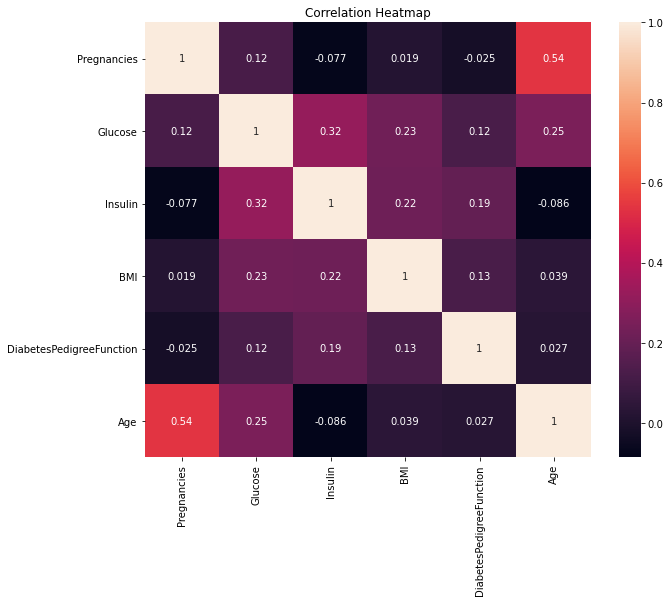

In [32]:
plt.subplots(figsize=(10,8))
ax = plt.axes()
ax.set_title("Correlation Heatmap")
corr = x.corr()
sns.heatmap(corr, annot=True,
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values)

## Data Splitting 

In [8]:
x = data.iloc[:,:-1]
y = data.iloc[:,-1]

In [9]:
x.drop(["SkinThickness"],axis=1,inplace=True)
x.drop(["BloodPressure"],axis=1,inplace=True)

In [10]:
x.tail()

,Pregnancies,Glucose,Insulin,BMI,DiabetesPedigreeFunction,Age
1995,2,75,55,29.7,0.370,33
1996,8,179,130,32.7,0.719,36
1997,6,85,0,31.2,0.382,42
1998,0,129,130,67.1,0.319,26
1999,2,81,76,30.1,0.547,25


In [15]:
x_train,x_test,y_train,y_test = train_test_split(x ,y ,test_size = 0.1 ,random_state= 44 ,shuffle = True )

# Fitting Model 

#### Popular algorithms that can be used for binary classification include:

- k-Nearest Neighbors
- Decision Trees
- Support Vector Machine


### KNeighborsClassifier

In [16]:
neg=KNeighborsClassifier(n_neighbors=1)
neg.fit(x_train,y_train)
y_pred=neg.predict(x_test)
print(' accuracy= ',accuracy_score(y_test,y_pred))
print(f'Train_score: {neg.score(x_train, y_train)}')
print(f'Test_score: {neg.score(x_test, y_test)}')

 accuracy=  1.0
Train_score: 1.0
Test_score: 1.0


### SVM

In [17]:
clf=SVC(C=1,gamma=1,kernel='rbf')
clf.fit(x_train,y_train)
svm_prediction=clf.predict(x_test)
print(' accuracy_score= ',accuracy_score(y_test,svm_prediction))
print(f'Train_score: {clf.score(x_train, y_train)}')
print(f'Test_score: {clf.score(x_test, y_test)}')

 accuracy_score=  1.0
Train_score: 1.0
Test_score: 1.0


Confusion_matrix for SVM 
 [[139   0]
 [  0  61]]


<AxesSubplot:>

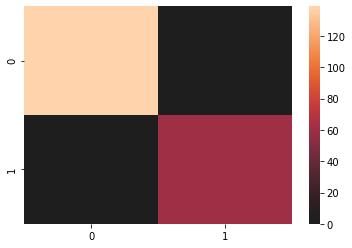

In [18]:
cm1=confusion_matrix(y_test,svm_prediction)
print('Confusion_matrix for SVM \n',cm1)
sns.heatmap(cm1,center=True)

In [19]:
print(classification_report(y_test,svm_prediction))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       139
           1       1.00      1.00      1.00        61

    accuracy                           1.00       200
   macro avg       1.00      1.00      1.00       200
weighted avg       1.00      1.00      1.00       200



### KNeighborsClassifier

In [20]:
knn=KNeighborsClassifier(n_neighbors=1)
knn.fit(x_train,y_train)
Knn_prediction=knn.predict(x_test)
print(' accuracy_score= ',accuracy_score(y_test,Knn_prediction))
print(f'Train_score: {neg.score(x_train, y_train)}')
print(f'Test_score: {neg.score(x_test, y_test)}')
 

 accuracy_score=  1.0
Train_score: 1.0
Test_score: 1.0


Confusion_matrix for KNeighborsClassifier 
 [[139   0]
 [  0  61]]


<AxesSubplot:>

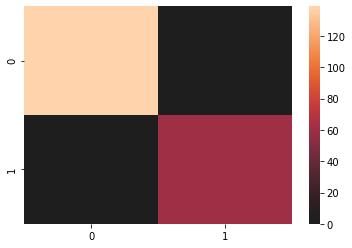

In [21]:
cm2=confusion_matrix(y_test,Knn_prediction)
print('Confusion_matrix for KNeighborsClassifier \n',cm2)
sns.heatmap(cm2,center=True)

In [22]:
print(classification_report(y_test,Knn_prediction))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       139
           1       1.00      1.00      1.00        61

    accuracy                           1.00       200
   macro avg       1.00      1.00      1.00       200
weighted avg       1.00      1.00      1.00       200



### DecisionTreeClassifier

In [28]:
ds=DecisionTreeClassifier()
ds.fit(x_train,y_train)
ds.score(x_train,y_train)
ds_prediction = ds.predict(x_test)
print(' accuracy= ',accuracy_score(y_test,ds_prediction))
print(f'Train_score: {ds.score(x_train, y_train)}')
print(f'Test_score: {ds.score(x_test, y_test)}')

 accuracy=  0.995
Train_score: 1.0
Test_score: 0.995


Confusion_matrix for DecisionTreeClassifier 
 [[138   1]
 [  0  61]]


<AxesSubplot:>

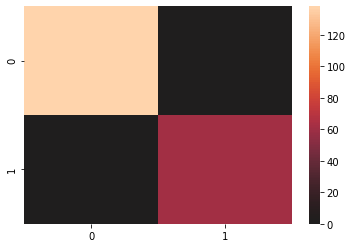

In [24]:
cm=confusion_matrix(y_test,ds_prediction)
print('Confusion_matrix for DecisionTreeClassifier \n',cm)
sns.heatmap(cm,center=True)


In [25]:
print(classification_report(y_test,ds_prediction))

              precision    recall  f1-score   support

           0       1.00      0.99      1.00       139
           1       0.98      1.00      0.99        61

    accuracy                           0.99       200
   macro avg       0.99      1.00      0.99       200
weighted avg       1.00      0.99      1.00       200



In [30]:
joblib.dump(clf,'SVM_Model.joblib')

['SVM_Model.joblib']